<a href="https://colab.research.google.com/github/saitej123/test/blob/main/NKI_Task_Sai.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#### **1.a. Write a brief note on the dataset and the research work from where this dataset originates. We expect no exploratory analysis.**
Ans: 
This data is provided by Netherlands Cancer Institute. https://www.nki.nl/ 
*   It is related to breast cancer patients:
    Patient details ,
    tumor details, Number of positive lymph nodes, Estrogen level, Hormonal therapy used (yes/no) ,Type of surgery (excision or mastectomy),chemotherapy ,Vascular invasion and 'gene expression details' in micro array data captured  included in the dataset 





#### **1.b. How do you think the creators of this dataset have calculated the values in column 17 to 1554? And what does the column names mean? Write a brief explanation based on your understanding and study.**
Ans: 
Genomics involves the analysis of large datasets of information derived from various biological experiments , it involves monitoring the expression levels of thousands of genes simultaneously under a particular condition, called "gene expression analysis". Microarray technology makes this possible and the quantity of data generated from each experiment is enormous, dwarfing the amount of data generated by genome sequencing 

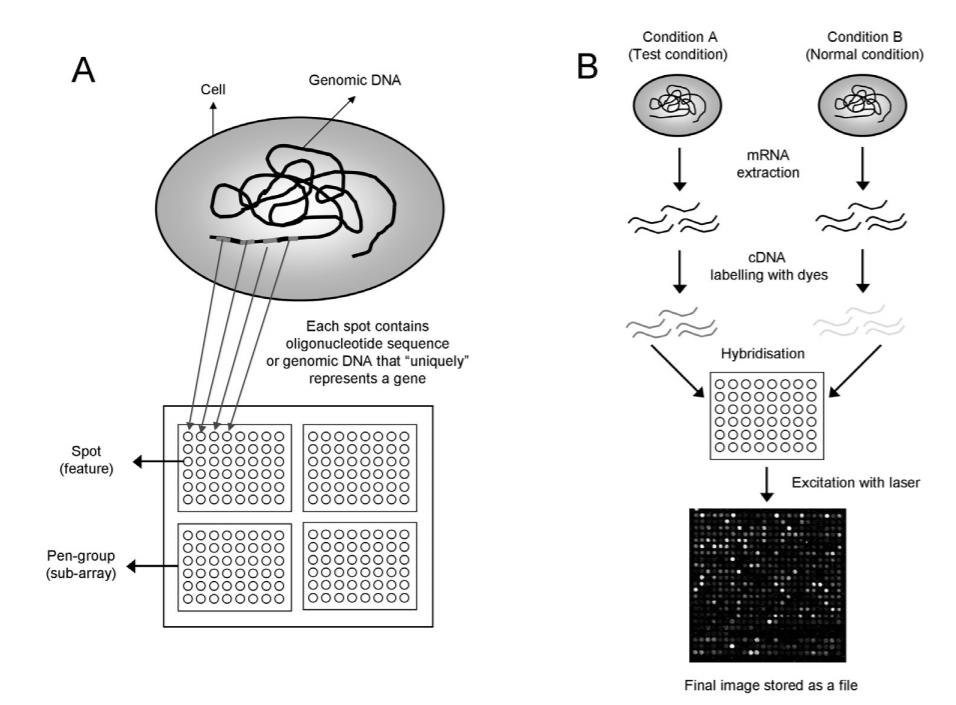
Source: https://www.mrc-lmb.cam.ac.uk/genomes/madanm/microarray/chapter-final.pdf


Normal tissue data were a set of 13 microarrays : four from reduction
mammoplasty and nine normal tissue samples from cancer
patients.  The DSGA transformation and gene thresholding produced a data matrix with 262 rows (genes).

### Pattern in column names based on sequence:
After removing numbers in columns , frequency of columns 

NM_  :750 ,

Contig _RC: 523,

AL : 61,

AF : 44,

Contig  :38,

AB  :35,

X  :19,

U : 19,

AK  :14,

M  :11,

AJ : 8,




#### **2.a. Perform some exploratory analysis using the dataset which helps in understanding the data and the problem at hand. The notebook in the link gives some starting point.**


In [ ]:
import pandas as pd
import numpy as np
import altair as alt
from sklearn.model_selection import train_test_split
import yellowbrick as yb
import statsmodels.api as sm
import scipy.stats as st
import matplotlib.pyplot as plt
import seaborn as sn
from sklearn.metrics import confusion_matrix
import matplotlib.mlab as mlab
from scipy.stats import chi2_contingency
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.svm import SVC
pd.set_option('display.max_columns', None)
%matplotlib inline
dataset = pd.read_csv('https://query.data.world/s/mtomgsgb3ef664tc7nhhosmpuwefyv')
dataset.info()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.metrics.classification module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.metrics. Anything that cannot be imported from sklearn.metrics is now part of the private API.
  warnings.warn(message, FutureWarning)
/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 272 entries, 0 to 271
Columns: 1570 entries, Patient to AF067420
dtypes: float64(1556), int64(13), object(1)
memory usage: 3.3+ MB


In [ ]:
X = dataset.drop(["Patient", "ID", "eventdeath"], axis=1)
y = dataset['eventdeath']

In [ ]:
_, y_counts = np.unique(y, return_counts=True)
class_labels = ["Alive", "Dead"]

In [ ]:
# Death vs Alive cases
bars= alt.Chart(dataset).mark_bar().encode(
    alt.X("eventdeath",axis=None),
    y='count()',
    color='eventdeath:N'
)
text = bars.mark_text(
    align='left',
    baseline='middle',
    dx=10 
).encode(
    text='count()'
)

(bars + text).properties(height=250, width=250)


alt.LayerChart(...)

In [ ]:
features = X.columns[:14]
eda_features=X.columns[:14].insert(14,'eventdeath')

In [ ]:
#correlation of features
corr = dataset[eda_features].corr()
corr.style.background_gradient(cmap='coolwarm').set_precision(2)

,age,survival,timerecurrence,chemo,hormonal,amputation,histtype,diam,posnodes,grade,angioinv,lymphinfil,barcode,esr1,eventdeath
age,1.00,0.08,0.13,-0.06,0.24,-0.00,-0.00,-0.03,-0.13,-0.11,0.04,-0.23,0.03,0.16,-0.15
survival,0.08,1.00,0.92,-0.00,-0.13,-0.03,-0.08,-0.03,-0.04,-0.17,-0.06,-0.11,0.09,0.24,-0.54
timerecurrence,0.13,0.92,1.00,0.03,-0.07,-0.03,-0.06,-0.06,-0.07,-0.18,-0.11,-0.09,0.10,0.22,-0.61
chemo,-0.06,-0.00,0.03,1.00,0.11,0.06,-0.01,0.09,0.53,-0.05,0.17,-0.01,0.25,0.03,-0.07
hormonal,0.24,-0.13,-0.07,0.11,1.00,0.07,0.00,0.04,0.11,-0.06,-0.03,-0.04,0.13,0.13,-0.10
amputation,-0.00,-0.03,-0.03,0.06,0.07,1.00,0.02,0.30,0.19,0.03,-0.01,-0.02,0.11,0.06,0.07
histtype,-0.00,-0.08,-0.06,-0.01,0.00,0.02,1.00,-0.02,0.06,-0.17,-0.10,-0.09,0.09,0.02,-0.01
diam,-0.03,-0.03,-0.06,0.09,0.04,0.30,-0.02,1.00,0.21,0.34,0.12,0.22,0.05,-0.17,0.22
posnodes,-0.13,-0.04,-0.07,0.53,0.11,0.19,0.06,0.21,1.00,0.06,0.19,0.02,0.23,-0.07,0.09
grade,-0.11,-0.17,-0.18,-0.05,-0.06,0.03,-0.17,0.34,0.06,1.00,0.17,0.43,-0.18,-0.45,0.36


In [ ]:
base = alt.Chart(dataset).encode(x='grade')
bar = base.mark_bar().encode(y='count(eventdeath)',color='grade:N')

line =  base.mark_line(color='purple').encode(
    y='count(eventdeath)'
)
(bar + line).properties(width=400)

alt.LayerChart(...)

In [ ]:
from autoviz.AutoViz_Class import AutoViz_Class
AV = AutoViz_Class()

Imported AutoViz_Class version: 0.0.81. Call using:
    from autoviz.AutoViz_Class import AutoViz_Class
    AV = AutoViz_Class()
    AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0,
                            lowess=False,chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 saves plots in your local machine under AutoViz_Plots directory and does not display charts.


Shape of your Data Set: (272, 15)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
    Number of Numeric Columns =  3
    Number of Integer-Categorical Columns =  7
    Number of String-Categorical Columns =  0
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  0
    Number of Numeric-Boolean Columns =  4
    Number of Discrete String Columns =  0
    Number of NLP String Columns =  0
    Number of Date Time Columns =  0
    Number of ID Columns =  1
    Number of Columns to Delete =  0
    15 Predictors classified...
        This does not include the Target column(s)
        1 variables removed since they were ID or low-information variables
Number of All Scatter Plots = 6


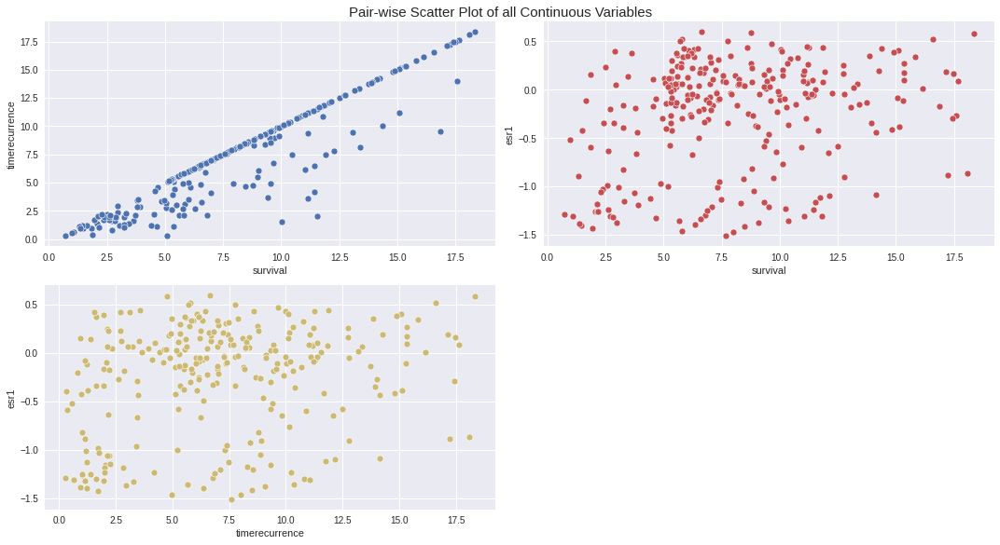

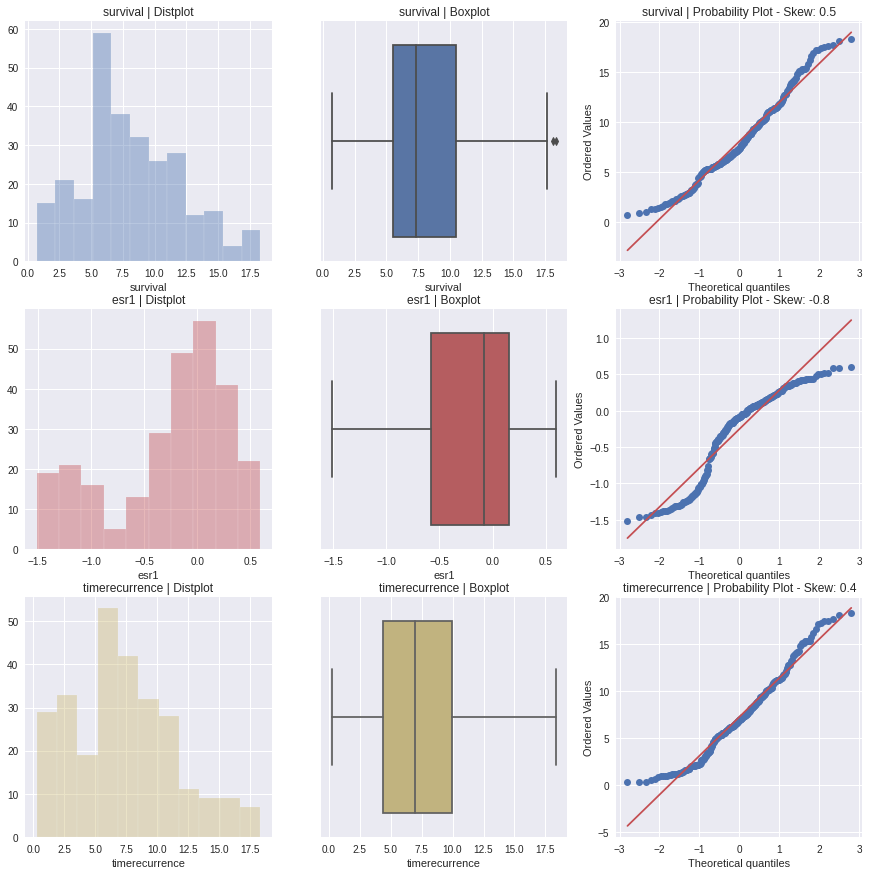

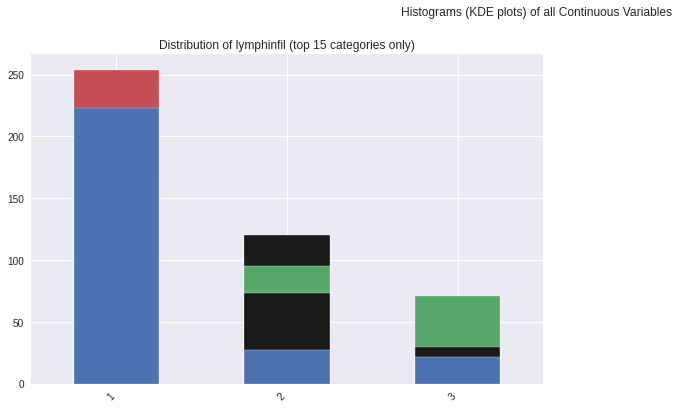

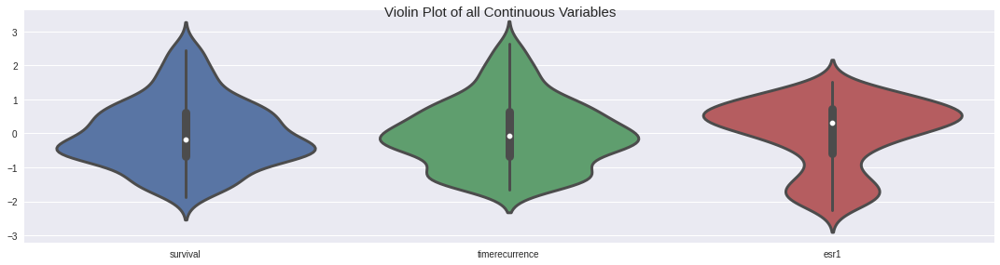

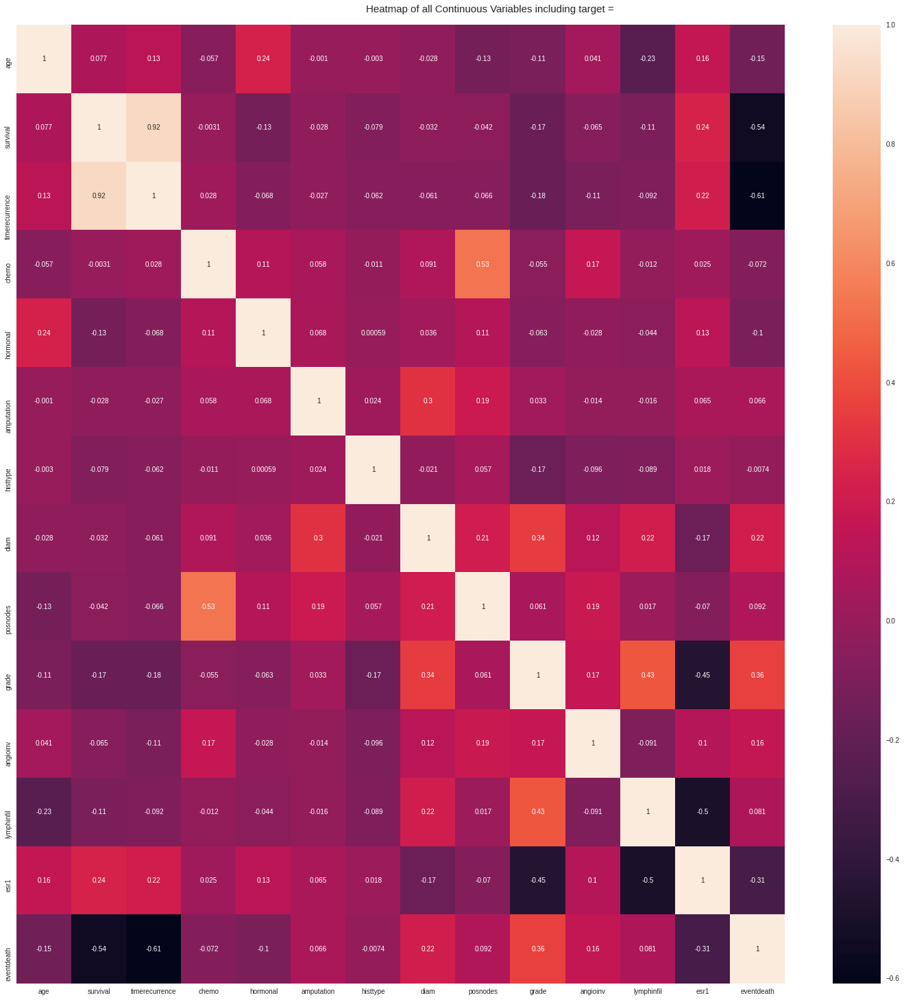

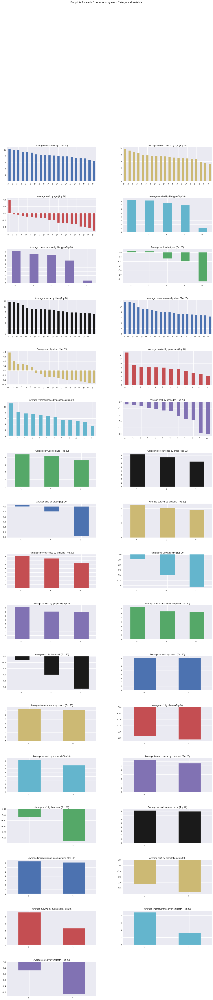

Time to run AutoViz (in seconds) = 13.501

 ###################### VISUALIZATION Completed ########################


,age,survival,timerecurrence,chemo,hormonal,amputation,histtype,diam,posnodes,grade,angioinv,lymphinfil,esr1,eventdeath
0,43,14.817248,14.817248,0,0,1,1,25,0,2,3,1,-0.413955,0
1,48,14.261465,14.261465,0,0,0,1,20,0,3,3,1,0.195251,0
2,38,6.644764,6.644764,0,0,0,1,15,0,2,1,1,0.596177,0
3,50,7.748118,7.748118,0,1,0,1,15,1,2,3,1,0.501286,0
4,38,6.436687,6.318960,0,0,1,1,15,0,2,2,1,-0.066771,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
267,48,2.608300,1.982204,1,0,1,1,30,0,3,1,3,-1.235442,1
268,39,5.504100,3.028063,0,0,1,1,30,0,2,1,1,0.062265,1
269,50,2.619200,2.149213,0,0,1,1,27,0,3,1,1,-0.635322,1
270,52,2.290500,2.209446,0,1,1,1,28,0,3,1,1,-1.055801,1


In [ ]:
AV.AutoViz(filename='',sep=",",dfte=dataset[eda_features])

#### **2.b. Choose 3 of your favorite machine learning models apart from the one given in the notebook and apply it on the dataset. Perform an analysis to compare the models using the model performance metrics. Also, show if hyper-parameter tuning improves the results in your comparison. You are free to build an ensemble model if you think it is going to be better than the individual models.**

In [ ]:
from scipy.stats.stats import pearsonr
p_values = X.apply(lambda col: pearsonr(col, y)[0])
threshold = 0.35
new_features = p_values[(p_values > threshold) | (p_values < -threshold)].index.values

In [ ]:
final_features= list(new_features)+ list(features) 
final_features=list(set(final_features))

In [ ]:
X[final_features].nunique()

diam               34
survival          261
histtype            5
NM_003981         272
Contig57584_RC    272
hormonal            2
NM_001333         272
NM_004701         272
barcode           272
NM_018410         272
posnodes           12
lymphinfil          3
age                27
Contig55725_RC    272
timerecurrence    262
NM_001168         272
chemo               2
angioinv            3
esr1              272
amputation          2
grade               3
dtype: int64

In [ ]:
cat_features=['amputation','chemo','histtype','hormonal','grade','lymphinfil','angioinv']

In [ ]:
num_features= [item for item in final_features if item not in cat_features]

In [ ]:
X_new=pd.get_dummies(X[final_features], prefix=cat_features, columns=cat_features)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X_new, y, test_size=0.3, random_state=143, shuffle = True, stratify=y)
X_train.shape

(190, 34)

#### Model 1: Random Forest

In [ ]:
rfc=RandomForestClassifier(random_state=123)

In [ ]:
param_grid = { 
    'n_estimators': [200, 500],
    'max_features': ['auto', 'sqrt', 'log2'],
    'max_depth' : [4,5,6,7,8],
    'criterion' :['gini', 'entropy']
}

In [ ]:
CV_rfc = GridSearchCV(estimator=rfc, param_grid=param_grid, cv= 5)
CV_rfc.fit(X_train, y_train)

GridSearchCV(cv=5, error_score=nan,
             estimator=RandomForestClassifier(bootstrap=True, ccp_alpha=0.0,
                                              class_weight=None,
                                              criterion='gini', max_depth=None,
                                              max_features='auto',
                                              max_leaf_nodes=None,
                                              max_samples=None,
                                              min_impurity_decrease=0.0,
                                              min_impurity_split=None,
                                              min_samples_leaf=1,
                                              min_samples_split=2,
                                              min_weight_fraction_leaf=0.0,
                                              n_estimators=100, n_jobs=None,
                                              oob_score=False, random_state=123,
                                 

In [ ]:
CV_rfc.best_params_

{'criterion': 'gini',
 'max_depth': 4,
 'max_features': 'auto',
 'n_estimators': 200}

In [ ]:
rfc1=RandomForestClassifier(random_state=123, max_features='auto', n_estimators= 200, max_depth=4, criterion='gini')

In [ ]:
rfc1.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=4, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=200,
                       n_jobs=None, oob_score=False, random_state=123,
                       verbose=0, warm_start=False)

In [ ]:
pred=rfc1.predict(X_test)

In [ ]:
print("Accuracy for Random Forest on CV data: ",accuracy_score(y_test,pred))

Accuracy for Random Forest on CV data:  0.8658536585365854


In [ ]:
# view the feature scores
feature_scores = pd.Series(rfc1.feature_importances_, index=X_train.columns).sort_values(ascending=False)
feature_scores

survival          0.237991
timerecurrence    0.222201
NM_004701         0.053713
esr1              0.049436
NM_003981         0.046541
Contig55725_RC    0.043193
NM_018410         0.041455
NM_001168         0.040567
diam              0.037876
NM_001333         0.033866
Contig57584_RC    0.033640
grade_3           0.030076
barcode           0.025726
age               0.025645
posnodes          0.019097
grade_1           0.007322
amputation_0      0.006227
histtype_1        0.006211
histtype_2        0.006066
angioinv_3        0.005078
chemo_0           0.004325
lymphinfil_1      0.003891
grade_2           0.003411
angioinv_1        0.003095
angioinv_2        0.002799
lymphinfil_3      0.002582
amputation_1      0.002356
hormonal_1        0.001463
hormonal_0        0.001390
chemo_1           0.001078
lymphinfil_2      0.001066
histtype_5        0.000621
histtype_4        0.000000
histtype_7        0.000000
dtype: float64

In [ ]:
from sklearn.feature_selection import SelectFromModel
sel = SelectFromModel(rfc1)
sel.fit(X_train, y_train)
sel.get_support()
selected_feat= X_train.columns[(sel.get_support())]
len(selected_feat)
print(selected_feat)

Index(['esr1', 'NM_001333', 'Contig57584_RC', 'survival', 'NM_004701',
       'NM_003981', 'timerecurrence', 'Contig55725_RC', 'NM_001168',
       'NM_018410', 'diam', 'grade_3'],
      dtype='object')


In [ ]:
rfc2=RandomForestClassifier(random_state=123, max_features='auto', n_estimators= 200, max_depth=4, criterion='gini',class_weight= {0 : 1,1: 2.52})
rfc2.fit(X_train[selected_feat], y_train)
pred_2=rfc2.predict(X_test[selected_feat])
accuracy_score(y_test,pred_2)

0.9024390243902439

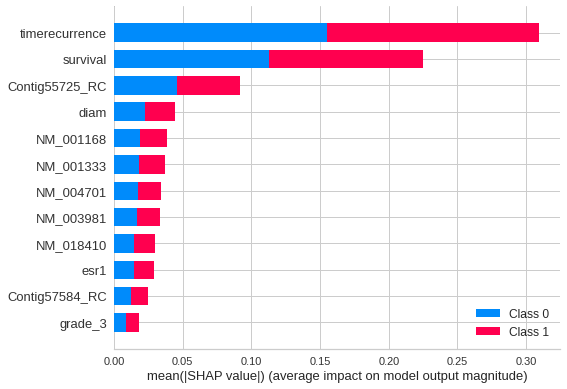

In [ ]:
import shap
explainer = shap.TreeExplainer(rfc2)
shap_values = explainer.shap_values(X_test[selected_feat])
shap.summary_plot(shap_values, X_test[selected_feat], plot_type="bar")

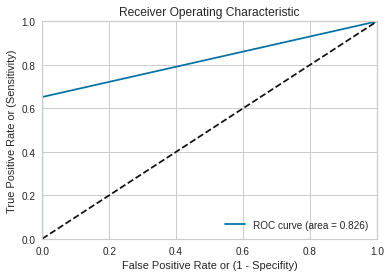

In [ ]:
from sklearn.metrics import roc_curve
from sklearn.metrics import auc,roc_auc_score

# Compute fpr, tpr, thresholds and roc auc
fpr, tpr, thresholds = roc_curve(y_test, pred_2)
roc_auc = roc_auc_score(y_test, pred_2)

# Plot ROC curve
plt.plot(fpr, tpr, label='ROC curve (area = %0.3f)' % roc_auc)
plt.plot([0, 1], [0, 1], 'k--')  # random predictions curve
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.xlabel('False Positive Rate or (1 - Specifity)')
plt.ylabel('True Positive Rate or (Sensitivity)')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")

In [ ]:
from sklearn.metrics import confusion_matrix, classification_report
print(confusion_matrix(y_test, pred_2))
print(classification_report(y_test, pred_2))

[[59  0]
 [ 8 15]]
              precision    recall  f1-score   support

           0       0.88      1.00      0.94        59
           1       1.00      0.65      0.79        23

    accuracy                           0.90        82
   macro avg       0.94      0.83      0.86        82
weighted avg       0.91      0.90      0.90        82



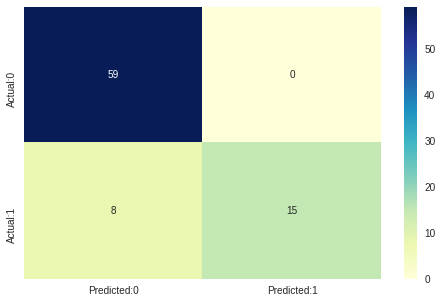

In [ ]:
from sklearn.metrics import confusion_matrix
cm=confusion_matrix(y_test,pred_2)
conf_matrix=pd.DataFrame(data=cm,columns=['Predicted:0','Predicted:1'],index=['Actual:0','Actual:1'])
plt.figure(figsize = (8,5))
sn.heatmap(conf_matrix, annot=True,fmt='d',cmap="YlGnBu")

#### Model 2: XGBOOST

In [ ]:
import time
from xgboost import XGBClassifier
xgb = XGBClassifier(n_estimators=100)
training_start = time.perf_counter()
xgb.fit(X_train, y_train)
training_end = time.perf_counter()
prediction_start = time.perf_counter()
preds = xgb.predict(X_test)
prediction_end = time.perf_counter()
acc_xgb = (preds == y_test).sum().astype(float) / len(preds)*100
xgb_train_time = training_end-training_start
xgb_prediction_time = prediction_end-prediction_start
print("XGBoost's prediction accuracy is: %3.2f" % (acc_xgb))
print("Time consumed for training: %4.3f" % (xgb_train_time))
print("Time consumed for prediction: %6.5f seconds" % (xgb_prediction_time))

XGBoost's prediction accuracy is: 86.59
Time consumed for training: 0.055
Time consumed for prediction: 0.00238 seconds


In [ ]:
from sklearn.metrics import confusion_matrix, classification_report
print(confusion_matrix(y_test, preds))
print(classification_report(y_test, preds))

[[57  2]
 [ 9 14]]
              precision    recall  f1-score   support

           0       0.86      0.97      0.91        59
           1       0.88      0.61      0.72        23

    accuracy                           0.87        82
   macro avg       0.87      0.79      0.81        82
weighted avg       0.87      0.87      0.86        82



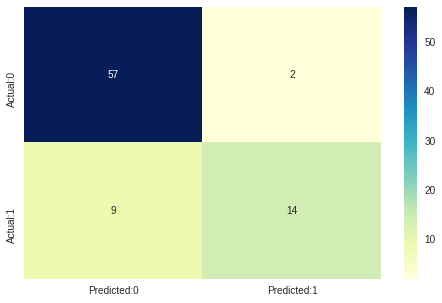

In [ ]:
from sklearn.metrics import confusion_matrix
cm=confusion_matrix(y_test,preds)
conf_matrix=pd.DataFrame(data=cm,columns=['Predicted:0','Predicted:1'],index=['Actual:0','Actual:1'])
plt.figure(figsize = (8,5))
sn.heatmap(conf_matrix, annot=True,fmt='d',cmap="YlGnBu")

In [ ]:
importances = pd.DataFrame({
    'Feature': X_train.columns,
    'Importance': xgb.feature_importances_
})
importances = importances.sort_values(by='Importance', ascending=False)
#importances = importances.set_index('Feature')
sel_features=list(importances.query(' Importance>0.01 ')['Feature'])


In [ ]:
from sklearn.utils.class_weight import compute_class_weight

class_weights = compute_class_weight('balanced', np.unique(y_train),  y_train)
class_weights=list(class_weights)
w_array = np.ones(y_train.shape[0], dtype = 'float')
for i, val in enumerate(y_train):
    w_array[i] = class_weights[val-1]

In [ ]:
xgb.fit(X_train[sel_features], y_train,sample_weight=w_array)
preds_2 = xgb.predict(X_test[sel_features])
acc_xgb = (preds_2 == y_test).sum().astype(float) / len(preds)*100
acc_xgb

89.02439024390245

In [ ]:
from sklearn.metrics import confusion_matrix, classification_report
print(confusion_matrix(y_test, preds_2))
print(classification_report(y_test, preds_2))

[[59  0]
 [ 9 14]]
              precision    recall  f1-score   support

           0       0.87      1.00      0.93        59
           1       1.00      0.61      0.76        23

    accuracy                           0.89        82
   macro avg       0.93      0.80      0.84        82
weighted avg       0.90      0.89      0.88        82



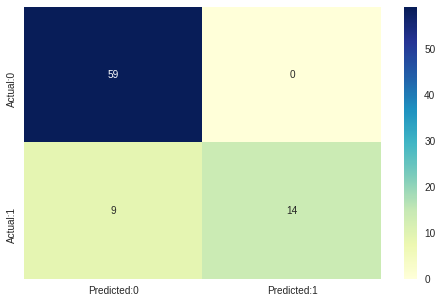

In [ ]:
from sklearn.metrics import confusion_matrix
cm=confusion_matrix(y_test,preds_2)
conf_matrix=pd.DataFrame(data=cm,columns=['Predicted:0','Predicted:1'],index=['Actual:0','Actual:1'])
plt.figure(figsize = (8,5))
sn.heatmap(conf_matrix, annot=True,fmt='d',cmap="YlGnBu")

#### Model 3:  LGBM

In [ ]:
# build the lightgbm model
import lightgbm as lgb
clf = lgb.LGBMClassifier(scale_pos_weight = 0.45,learning_rate=0.03,boosting_type='gbdt',objective='binary',max_depth=2050,num_iterations=200,metric='auc')
clf.fit(X_train, y_train)


/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:118: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.03, max_depth=2050,
               metric='auc', min_child_samples=20, min_child_weight=0.001,
               min_split_gain=0.0, n_estimators=100, n_jobs=-1,
               num_iterations=200, num_leaves=31, objective='binary',
               random_state=None, reg_alpha=0.0, reg_lambda=0.0,
               scale_pos_weight=0.45, silent=True, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0)

In [ ]:
# predict the results
y_pred=clf.predict(X_test)

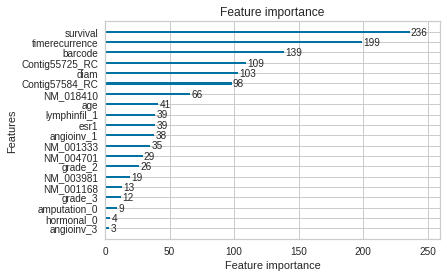

In [ ]:
lgb.plot_importance(clf, max_num_features=20)

In [ ]:
# view accuracy
from sklearn.metrics import accuracy_score
accuracy=accuracy_score(y_pred, y_test)

print('LightGBM Model accuracy score: {0:0.4f}'.format(accuracy_score(y_test, y_pred)))

LightGBM Model accuracy score: 0.8780


In [ ]:
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[59  0]
 [10 13]]
              precision    recall  f1-score   support

           0       0.86      1.00      0.92        59
           1       1.00      0.57      0.72        23

    accuracy                           0.88        82
   macro avg       0.93      0.78      0.82        82
weighted avg       0.90      0.88      0.87        82



In [ ]:
clf.booster_.feature_importance()
# importance of each attribute
fea_imp_ = pd.DataFrame({'cols':X_train.columns, 'fea_imp':clf.feature_importances_})
fet=fea_imp_.loc[fea_imp_.fea_imp > 0].sort_values(by=['fea_imp'], ascending = False)
sel_features=list(fet.query('fea_imp>20')['cols'])

In [ ]:
clf_1= lgb.LGBMClassifier(scale_pos_weight = 0.4,learning_rate=0.03,boosting_type='gbdt',objective='binary',max_depth=2050,num_iterations=200,metric='auc')
clf_1.fit(X_train[sel_features], y_train)

/usr/local/lib/python3.7/dist-packages/lightgbm/engine.py:118: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.03, max_depth=2050,
               metric='auc', min_child_samples=20, min_child_weight=0.001,
               min_split_gain=0.0, n_estimators=100, n_jobs=-1,
               num_iterations=200, num_leaves=31, objective='binary',
               random_state=None, reg_alpha=0.0, reg_lambda=0.0,
               scale_pos_weight=0.4, silent=True, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0)

In [ ]:
# predict the results
y_pred=clf_1.predict(X_test[sel_features])
accuracy=accuracy_score(y_pred, y_test)
print('LightGBM Model accuracy score: {0:0.4f}'.format(accuracy_score(y_test, y_pred)))

LightGBM Model accuracy score: 0.8780


In [ ]:
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[59  0]
 [10 13]]
              precision    recall  f1-score   support

           0       0.86      1.00      0.92        59
           1       1.00      0.57      0.72        23

    accuracy                           0.88        82
   macro avg       0.93      0.78      0.82        82
weighted avg       0.90      0.88      0.87        82



##### Recursive Feature Elimination(RFE) can be tried to check the each  feature importance 

#### **3. In taking a data science project from prototype to production,  highlight at least five challenges that you have faced in your past projects.**

Ans:

*   **Understanding Business Requirement** : Need to understand what is the problem and how ML can solve that issue. ML cannot be solution for all business problems ,need to choose ML properly based on requirement and assigned the sub tasks to the team members 
*   **Choosing Right data for analysis** : For given problem based on type of situation need to select right metrics and combine data from multiple sources , features in ML should be relevant to the given business problem
*  **Data Cleaning and Data Preparation** : It is the most challenging task in any ML task. Right from data types to data quality wee to ensure our data is ready for ML tasks , if some issue in duplicates or some imbalances in data that may impact model performance so data cleaning itself takes 70% of time 
*   **Deployments and Continuous integration** : Model development is not one time task , over period of time data increases and our predictions we can validate and need to build pipeline for continuous changes  in data preparation and new state of art models and techniques 
*  **ML as service or Products or API**: Model building cannot be final step bringing ML to production via service or product or REST api is important so MLOps is crucial for successful business operations " Ex: ML based  recommendation engine if it fails in production may gives bad user experience so it may impact business  "







In [ ]:
##Exta 

In [ ]:
#find the columns pattern
k=list(dataset.columns)
import re
p= [re.sub("\d+", " ", i) for i in k ] 
d=list(set(p))
from collections import Counter
ct=Counter(p)
for w in sorted(ct, key=ct.get, reverse=True):
    print(w, ct[w])

NM_  750
Contig _RC 523
AL  61
AF  44
Contig  38
AB  35
X  19
U  19
AK  14
M  11
AJ  8
D  6
J  5
L  3
AW _RC 2
S  2
Y  2
K  2
Z  2
Patient 1
ID 1
age 1
eventdeath 1
survival 1
timerecurrence 1
chemo 1
hormonal 1
amputation 1
histtype 1
diam 1
posnodes 1
grade 1
angioinv 1
lymphinfil 1
barcode 1
esr  1
G PDH_  1
AA _RC 1
R _RC 1
NC_  1
AI _RC 1
T _RC 1
V  1
